In [2]:
# install.packages("ranger")
# install.packages("tidymodels")
# install.packages("vip")
# install.packages("broom")

In [3]:
library(ranger)
library(tidyverse)
library(tidymodels)
library(vip)
library(broom)

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.0     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.1
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
── Attaching packages ────────────────────────────────────── tidymodels 1.1.1 ──

✔ broom        1.0.5      ✔ rsample      1.2.0 
✔ dials        1.2.1      ✔ tune         1.1.2 
✔ infer        1.0.6      ✔ workflows    1.1.4 
✔ modeldata    1.3.0      ✔ workflowsets 1.0.1 
✔ parsnip      1.2.0      ✔ yardstick    1.3.0 
✔ recipes      1.0.10     

── Conflicts ───────────────────────────────────────── tidymodels_conflicts() ──
✖ scales::discard() masks purrr::discard()
✖ 

In [5]:
insurance = read_csv('../DataSets/insurance.csv')

glimpse(insurance)

Rows: 1338 Columns: 7
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr (3): sex, smoker, region
dbl (4): age, bmi, children, charges

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


Rows: 1,338
Columns: 7
$ age      <dbl> 19, 18, 28, 33, 32, 31, 46, 37, 37, 60, 25, 62, 23, 56, 27, 1…
$ sex      <chr> "female", "male", "male", "male", "male", "female", "female",…
$ bmi      <dbl> 27.900, 33.770, 33.000, 22.705, 28.880, 25.740, 33.440, 27.74…
$ children <dbl> 0, 1, 3, 0, 0, 0, 1, 3, 2, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0…
$ smoker   <chr> "yes", "no", "no", "no", "no", "no", "no", "no", "no", "no", …
$ region   <chr> "southwest", "southeast", "southeast", "northwest", "northwes…
$ charges  <dbl> 16884.924, 1725.552, 4449.462, 21984.471, 3866.855, 3756.622,…


In [6]:
lm1 <- lm(charges ~ ., data = insurance)
summary(lm1)

# are there any missing values ?
any(is.na(insurance))



Call:
lm(formula = charges ~ ., data = insurance)

Residuals:
     Min       1Q   Median       3Q      Max 
-11304.9  -2848.1   -982.1   1393.9  29992.8 

Coefficients:
                Estimate Std. Error t value Pr(>|t|)    
(Intercept)     -11938.5      987.8 -12.086  < 2e-16 ***
age                256.9       11.9  21.587  < 2e-16 ***
sexmale           -131.3      332.9  -0.394 0.693348    
bmi                339.2       28.6  11.860  < 2e-16 ***
children           475.5      137.8   3.451 0.000577 ***
smokeryes        23848.5      413.1  57.723  < 2e-16 ***
regionnorthwest   -353.0      476.3  -0.741 0.458769    
regionsoutheast  -1035.0      478.7  -2.162 0.030782 *  
regionsouthwest   -960.0      477.9  -2.009 0.044765 *  
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 6062 on 1329 degrees of freedom
Multiple R-squared:  0.7509,	Adjusted R-squared:  0.7494 
F-statistic: 500.8 on 8 and 1329 DF,  p-value: < 2.2e-16


[1] FALSE

### Main split of the data   

In [7]:
set.seed(1234)
splits   <- initial_split(insurance, prop = 0.75)
train_tbl <- training(splits)
test_tbl  <- testing(splits)


In [8]:
train_tbl

age,sex,bmi,children,smoker,region,charges
<dbl>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>
32,male,28.120,4,yes,northwest,21472.479
26,female,34.200,2,no,southwest,3987.926
23,female,42.750,1,yes,northeast,40904.200
48,male,29.600,0,no,southwest,21232.182
49,female,21.300,1,no,southwest,9182.170
60,female,35.100,0,no,southwest,12644.589
43,male,35.310,2,no,southeast,18806.145
45,female,35.300,0,no,southwest,7348.142
18,female,38.170,0,no,southeast,1631.668


In [9]:
test_tbl

age,sex,bmi,children,smoker,region,charges
<dbl>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>
28,male,33.000,3,no,southeast,4449.462
32,male,28.880,0,no,northwest,3866.855
37,female,27.740,3,no,northwest,7281.506
62,female,26.290,0,yes,southeast,27808.725
27,male,42.130,0,yes,southeast,39611.758
19,male,24.600,1,no,southwest,1837.237
23,male,23.845,0,no,northeast,2395.172
60,female,36.005,0,no,northeast,13228.847
30,female,32.400,1,no,southwest,4149.736


### The recipe for data preparation - not all steps (in the following recipe) are really necessary

In [10]:
the_recipe <- recipe(charges ~ ., data = train_tbl) %>%
    step_dummy(all_nominal(), -all_outcomes()) %>% # dummification of the predictors
    step_impute_knn(all_predictors(), neighbors = 3) %>%   # ... when having missing values
    step_zv(all_predictors()) # this removes predictors with zero variance

### Models Specification

In [11]:
lm_spec <- linear_reg() %>%
  set_engine("lm") %>%
  set_mode("regression")

rf_spec <- rand_forest() %>%
     set_engine("ranger") %>%
     set_mode("regression")

### Assemble the workflows and fit the models

In [12]:
### the liniar regression model
set.seed(1234)
lm_fit <- workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(lm_spec) %>%
    fit(data = train_tbl)

# examine the resulted tibble
lm_fit

══ Workflow [trained] ══════════════════════════════════════════════════════════
Preprocessor: Recipe
Model: linear_reg()

── Preprocessor ────────────────────────────────────────────────────────────────
3 Recipe Steps

• step_dummy()
• step_impute_knn()
• step_zv()

── Model ───────────────────────────────────────────────────────────────────────

Call:
stats::lm(formula = ..y ~ ., data = data)

Coefficients:
     (Intercept)               age               bmi          children  
       -11314.94            254.16            327.15            446.92  
        sex_male        smoker_yes  region_northwest  region_southeast  
          -95.88          24221.78           -268.61          -1370.70  
region_southwest  
         -800.95  


In [15]:
lm_fit_summary <- broom::glance(lm_fit)
lm_fit_summary

r.squared,adj.r.squared,sigma,statistic,p.value,df,logLik,AIC,BIC,deviance,df.residual,nobs
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>
0.7449103,0.7428573,6256.579,362.8336,1.147392e-288,8,-10186.29,20392.58,20441.68,38909906762,994,1003


In [19]:
lm_fit_coefficients <- broom::tidy (lm_fit)

In [20]:
lm_fit_coefficients

term,estimate,std.error,statistic,p.value
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
(Intercept),-11314.94182,1153.07332,-9.8128555,9.288509e-22
age,254.15907,14.12350,17.9954710,6.860419e-63
bmi,327.15041,33.72295,9.7011214,2.537845e-21
children,446.92151,167.32164,2.6710323,7.685382e-03
sex_male,-95.87741,397.14759,-0.2414151,8.092832e-01
smoker_yes,24221.78370,490.89169,49.3424193,1.661865e-269
region_northwest,-268.61476,570.11574,-0.4711583,6.376311e-01
region_southeast,-1370.70152,570.51798,-2.4025562,1.646345e-02
region_southwest,-800.94743,564.48475,-1.4189000,1.562416e-01


### Model predictions on the training set


In [21]:
# model predictions on the training set
lm_fit_predictions <- broom::augment (lm_fit, new_data = train_tbl)
# ..or
lm_fit_predictions2 <- bind_cols(train_tbl,
     predict (lm_fit, new_data = train_tbl))

identical(lm_fit_predictions$charges, lm_fit_predictions2$charges)
lm_fit_predictions

[1] TRUE

.pred,.resid,age,sex,bmi,children,smoker,region,charges
<dbl>,<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>
31662.5957,-10190.11686,32,male,28.120,4,yes,northwest,21472.479
6574.6337,-2586.70773,26,female,34.200,2,no,southwest,3987.926
33185.1021,7719.09737,23,female,42.750,1,yes,northeast,40904.200
9671.5210,11560.66123,48,male,29.600,0,no,southwest,21232.182
7753.1306,1429.03938,49,female,21.300,1,no,southwest,9182.170
14616.6346,-1972.04558,60,female,35.100,0,no,southwest,12644.589
10592.8434,8213.30203,43,male,35.310,2,no,southeast,18806.145
10869.6786,-3521.53656,45,female,35.300,0,no,southwest,7348.142
4376.5511,-2744.88285,18,female,38.170,0,no,southeast,1631.668


### Random forest classification model

![](../misc/dt.png)

![](../misc/random-forest.webp)

In [24]:
set.seed(1234)
rf_fit <- workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(rf_spec) %>%
    fit(data = train_tbl)

rf_fit

══ Workflow [trained] ══════════════════════════════════════════════════════════
Preprocessor: Recipe
Model: rand_forest()

── Preprocessor ────────────────────────────────────────────────────────────────
3 Recipe Steps

• step_dummy()
• step_impute_knn()
• step_zv()

── Model ───────────────────────────────────────────────────────────────────────
Ranger result

Call:
 ranger::ranger(x = maybe_data_frame(x), y = y, num.threads = 1,      verbose = FALSE, seed = sample.int(10^5, 1)) 

Type:                             Regression 
Number of trees:                  500 
Sample size:                      1003 
Number of independent variables:  8 
Mtry:                             2 
Target node size:                 5 
Variable importance mode:         none 
Splitrule:                        variance 
OOB prediction error (MSE):       29089884 
R squared (OOB):                  0.8089081 

### Random forest predictions on train data

In [26]:
rf_fit_predictions <- broom::augment(rf_fit, new_data = train_tbl)
rf_fit_predictions

.pred,age,sex,bmi,children,smoker,region,charges
<dbl>,<dbl>,<chr>,<dbl>,<dbl>,<chr>,<chr>,<dbl>
21286.103,32,male,28.120,4,yes,northwest,21472.479
7711.156,26,female,34.200,2,no,southwest,3987.926
37605.794,23,female,42.750,1,yes,northeast,40904.200
13165.707,48,male,29.600,0,no,southwest,21232.182
11840.091,49,female,21.300,1,no,southwest,9182.170
13296.430,60,female,35.100,0,no,southwest,12644.589
13685.935,43,male,35.310,2,no,southeast,18806.145
9654.715,45,female,35.300,0,no,southwest,7348.142
4777.949,18,female,38.170,0,no,southeast,1631.668


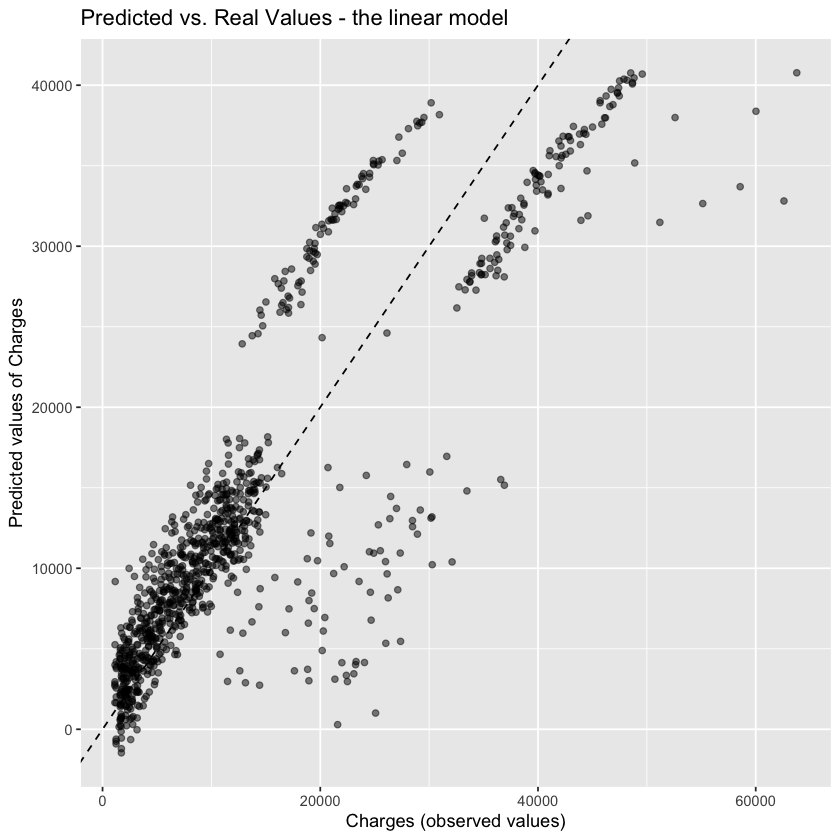

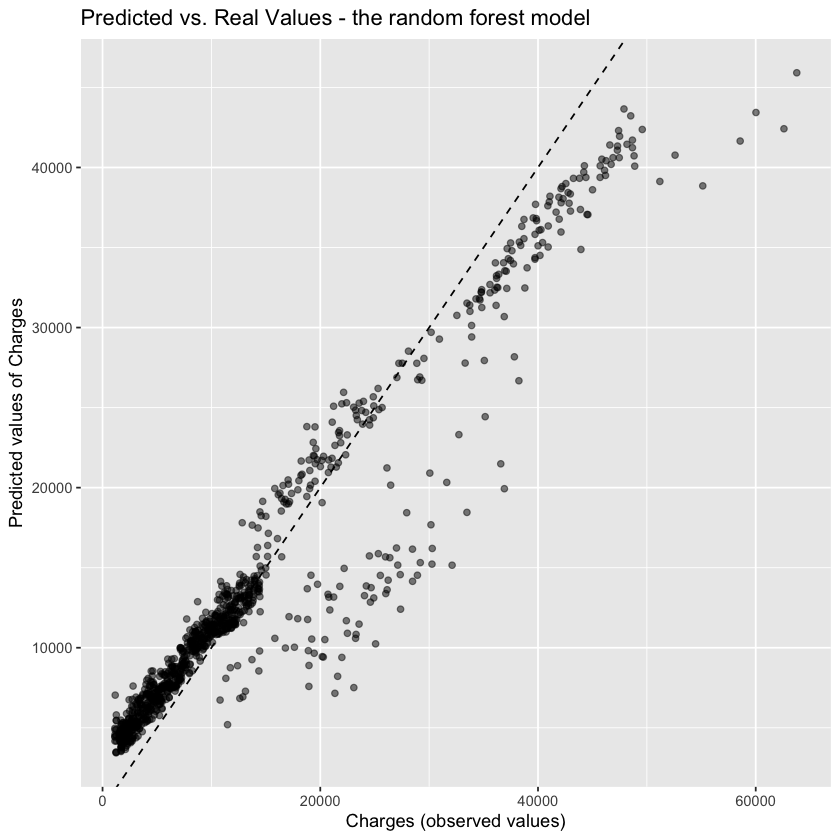

In [27]:
broom::augment (lm_fit, new_data = train_tbl) %>%
     ggplot( aes (x = charges, y = `.pred`)) +
     geom_abline(lty = 2) + 
     geom_point(alpha = 0.5) +
     labs(y = "Predicted values of Charges", x = "Charges (observed values)") +
     ggtitle('Predicted vs. Real Values - the linear model')

broom::augment(rf_fit, new_data = train_tbl) %>%
     ggplot( aes (x = charges, y = `.pred`)) +
     geom_abline(lty = 2) + 
     geom_point(alpha = 0.5) +
     labs(y = "Predicted values of Charges", x = "Charges (observed values)") +
     ggtitle('Predicted vs. Real Values - the random forest model')

**Task10 plot true and pred values for lr model**

**Task11 plot true and pred values for rf model**

###     The moment of truth: model performance on the test data set


In [28]:
scoring_metrics <- metric_set(rmse, rsq, mae, ccc)

set.seed(1234)
test__lm <- broom::augment(lm_fit, new_data = test_tbl)
scoring_metrics(test__lm, truth = charges, estimate = .pred)

set.seed(1234)
test__rf <- broom::augment(rf_fit, new_data = test_tbl)
scoring_metrics(test__rf, truth = charges, estimate = .pred)


.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
rmse,standard,5482.2172626
rsq,standard,0.7729501
mae,standard,3893.4151732
ccc,standard,0.8736772


.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
rmse,standard,4570.1227991
rsq,standard,0.8633320
mae,standard,3375.9934824
ccc,standard,0.9002828


**Task12 define scoring metrics - rmse, rsq, mae, ccc**

**Task13 make predictions on test data for lr model**

**Task14 make predictions on test data for rf model**

### Model interpretation

#### Variable importance - Random Forest

#### Coefficients - Logistic Regression

In [29]:
lm_fit
lm_fit_coefficients <- broom::tidy (lm_fit)
lm_fit_coefficients
# ...or...
lm_fit_coefficients2 <- broom::tidy(extract_fit_parsnip(lm_fit))
identical(lm_fit_coefficients, lm_fit_coefficients2)

══ Workflow [trained] ══════════════════════════════════════════════════════════
Preprocessor: Recipe
Model: linear_reg()

── Preprocessor ────────────────────────────────────────────────────────────────
3 Recipe Steps

• step_dummy()
• step_impute_knn()
• step_zv()

── Model ───────────────────────────────────────────────────────────────────────

Call:
stats::lm(formula = ..y ~ ., data = data)

Coefficients:
     (Intercept)               age               bmi          children  
       -11314.94            254.16            327.15            446.92  
        sex_male        smoker_yes  region_northwest  region_southeast  
          -95.88          24221.78           -268.61          -1370.70  
region_southwest  
         -800.95  


term,estimate,std.error,statistic,p.value
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
(Intercept),-11314.94182,1153.07332,-9.8128555,9.288509e-22
age,254.15907,14.12350,17.9954710,6.860419e-63
bmi,327.15041,33.72295,9.7011214,2.537845e-21
children,446.92151,167.32164,2.6710323,7.685382e-03
sex_male,-95.87741,397.14759,-0.2414151,8.092832e-01
smoker_yes,24221.78370,490.89169,49.3424193,1.661865e-269
region_northwest,-268.61476,570.11574,-0.4711583,6.376311e-01
region_southeast,-1370.70152,570.51798,-2.4025562,1.646345e-02
region_southwest,-800.94743,564.48475,-1.4189000,1.562416e-01


[1] TRUE

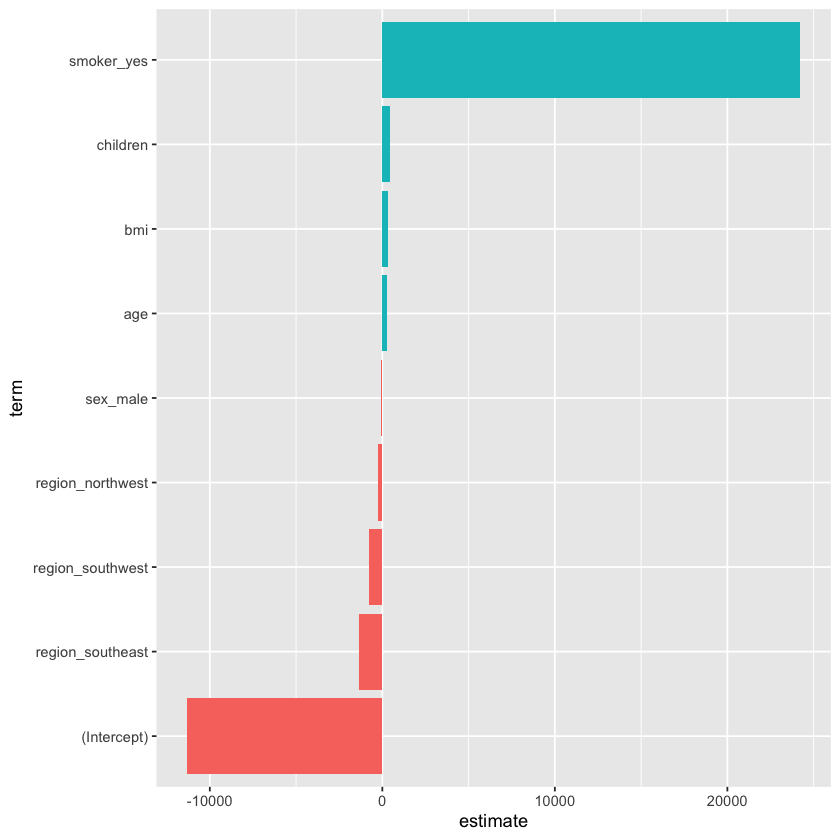

In [31]:
lm_fit %>%
    tidy() %>%
    mutate(term = fct_reorder(term, estimate)) %>%
    ggplot(aes(estimate, term, fill = estimate > 0)) +
    geom_col() +
    theme(legend.position = "none")

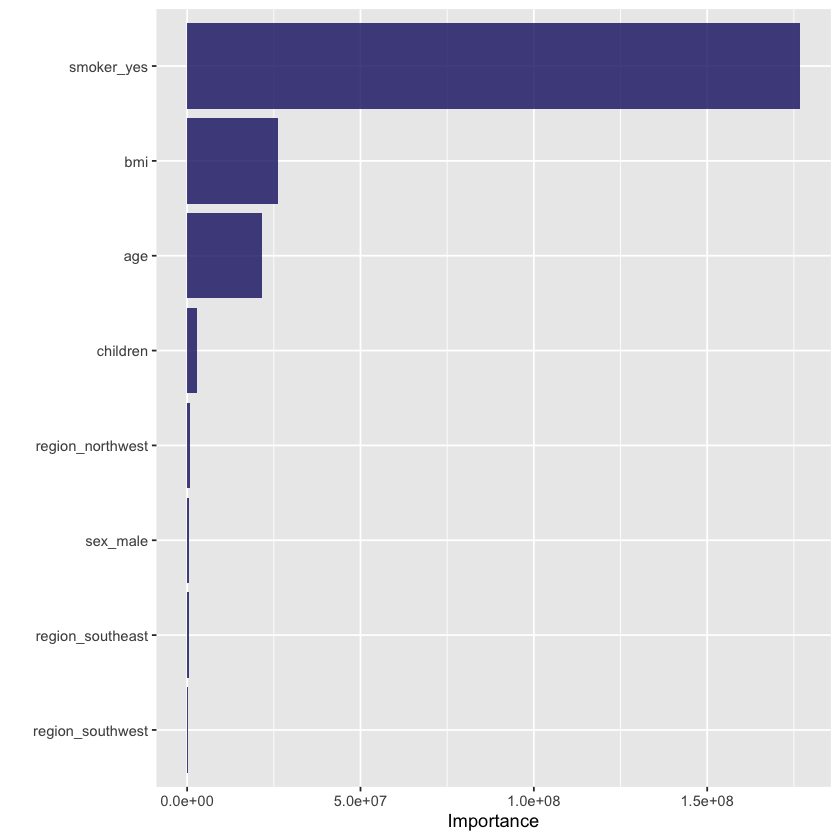

In [30]:
set.seed(1234)
rf_imp_spec <- rf_spec %>%
    set_engine("ranger", importance = "permutation")

workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(rf_imp_spec) %>%
    fit(train_tbl) %>%
    extract_fit_parsnip() %>%
    vip(aesthetics = list(alpha = 0.8, fill = "midnightblue"))


**Task15 display coeeficients of lr model**


**Task16 display variable importances for rf model**

---
---
---

In [33]:
## cross-validation folds
set.seed(1234)
cv_train <- vfold_cv(train_tbl, v = 5, repeats = 5)
cv_train


splits                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

### Assemble the workflows and fit the models

In [34]:
set.seed(1234)
lm_resamples <- workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(lm_spec) %>%
    fit_resamples(resamples = cv_train, 
                  control = control_resamples(save_pred = TRUE))


# examine the resulted tibble
View(lm_resamples)

splits                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

In [35]:
set.seed(1234)
rf_resamples <- workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(rf_spec) %>%
    fit_resamples(resamples = cv_train, 
                  control = control_resamples(save_pred = TRUE))


# examine the resulted tibble
View(rf_resamples)

splits                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                          

### Explore the results

In [36]:
# performance metrics (mean) across folds for each grid line
lm_resamples %>% collect_metrics()

#  get the metrics for each resample
detailed_metrics_lm <- lm_resamples %>% collect_metrics(summarize = FALSE)
View(detailed_metrics_lm)  

glimpse(detailed_metrics_lm)

.metric,.estimator,mean,n,std_err,.config
<chr>,<chr>,<dbl>,<int>,<dbl>,<chr>
rmse,standard,6294.0242925,25,54.759561404,Preprocessor1_Model1
rsq,standard,0.7400322,25,0.007527847,Preprocessor1_Model1


id,id2,.metric,.estimator,.estimate,.config
<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>
Repeat1,Fold1,rmse,standard,6050.7485189,Preprocessor1_Model1
Repeat1,Fold1,rsq,standard,0.7659185,Preprocessor1_Model1
Repeat1,Fold2,rmse,standard,6482.7719836,Preprocessor1_Model1
Repeat1,Fold2,rsq,standard,0.7509057,Preprocessor1_Model1
Repeat1,Fold3,rmse,standard,6817.4189017,Preprocessor1_Model1
Repeat1,Fold3,rsq,standard,0.6697600,Preprocessor1_Model1
Repeat1,Fold4,rmse,standard,6219.8603315,Preprocessor1_Model1
Repeat1,Fold4,rsq,standard,0.7586827,Preprocessor1_Model1
Repeat1,Fold5,rmse,standard,5763.8179349,Preprocessor1_Model1


Rows: 50
Columns: 6
$ id         <chr> "Repeat1", "Repeat1", "Repeat1", "Repeat1", "Repeat1", "Rep…
$ id2        <chr> "Fold1", "Fold1", "Fold2", "Fold2", "Fold3", "Fold3", "Fold…
$ .metric    <chr> "rmse", "rsq", "rmse", "rsq", "rmse", "rsq", "rmse", "rsq",…
$ .estimator <chr> "standard", "standard", "standard", "standard", "standard",…
$ .estimate  <dbl> 6050.7485189, 0.7659185, 6482.7719836, 0.7509057, 6817.4189…
$ .config    <chr> "Preprocessor1_Model1", "Preprocessor1_Model1", "Preprocess…


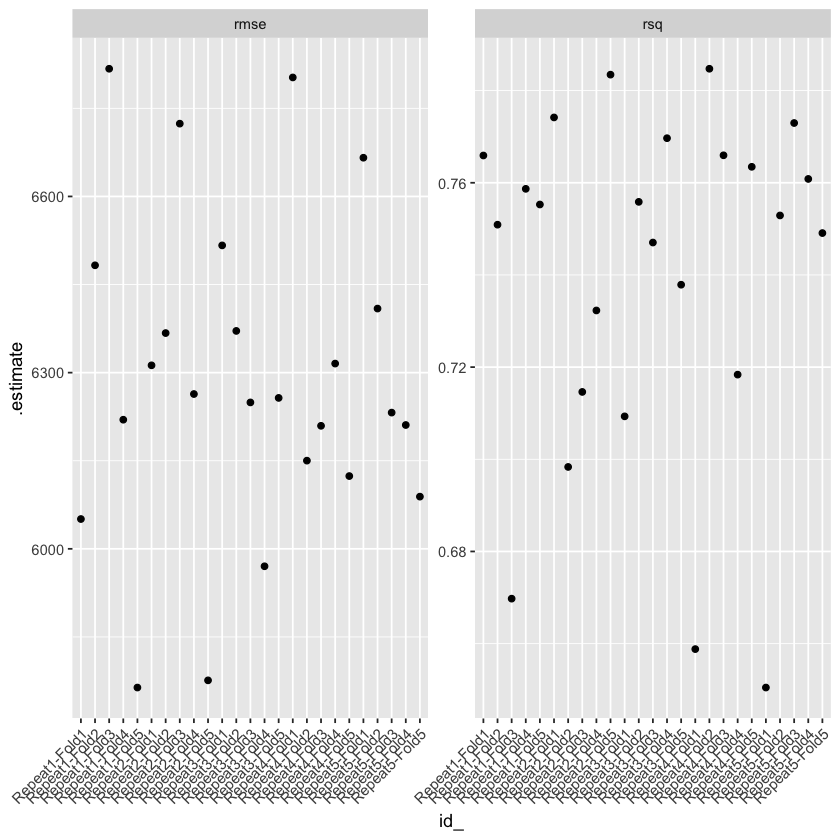

In [37]:
detailed_metrics_lm %>% 
     ungroup() %>%
     mutate (id_ = paste(id, id2, sep = '-')) |>
ggplot(aes (x = id_, y = `.estimate`)) +
    geom_point() +
    facet_wrap(~ `.metric`, scales = 'free') +
     theme(axis.text.x = element_text(size = 9, angle = 45, hjust = 1))
     

.metric,.estimator,mean,n,std_err,.config
<chr>,<chr>,<dbl>,<int>,<dbl>,<chr>
rmse,standard,5451.7851879,25,46.576766475,Preprocessor1_Model1
rsq,standard,0.8346099,25,0.005448857,Preprocessor1_Model1


id,id2,.metric,.estimator,.estimate,.config
<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>
Repeat1,Fold1,rmse,standard,5219.8035185,Preprocessor1_Model1
Repeat1,Fold1,rsq,standard,0.8590779,Preprocessor1_Model1
Repeat1,Fold2,rmse,standard,5547.4821650,Preprocessor1_Model1
Repeat1,Fold2,rsq,standard,0.8395335,Preprocessor1_Model1
Repeat1,Fold3,rmse,standard,5885.7358917,Preprocessor1_Model1
Repeat1,Fold3,rsq,standard,0.7797197,Preprocessor1_Model1
Repeat1,Fold4,rmse,standard,5554.0462870,Preprocessor1_Model1
Repeat1,Fold4,rsq,standard,0.8449972,Preprocessor1_Model1
Repeat1,Fold5,rmse,standard,5149.7395827,Preprocessor1_Model1


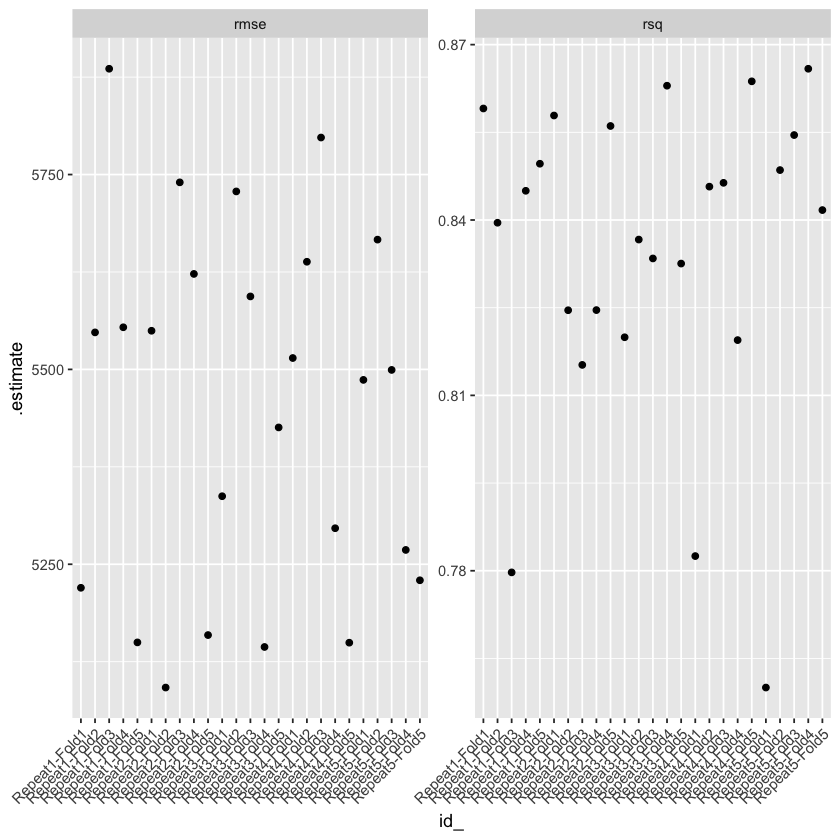

In [38]:
# performance metrics (mean) across folds for each grid line
rf_resamples %>% collect_metrics()

#  get the metrics for each resample
detailed_metrics_rf <- rf_resamples %>% collect_metrics(summarize = FALSE)
View(detailed_metrics_rf)  

detailed_metrics_rf %>% 
     ungroup() %>%
     mutate (id_ = paste(id, id2, sep = '-')) |>
ggplot(aes (x = id_, y = `.estimate`)) +
    geom_point() +
    facet_wrap(~ `.metric`, scales = 'free') +
     theme(axis.text.x = element_text(size = 9, angle = 45, hjust = 1))


###     The moment of truth: model performance on the test data set


In [39]:
set.seed(1234)
test__lm <- workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(lm_spec) %>%
    last_fit(splits) 

test__lm %>% collect_metrics() 


.metric,.estimator,.estimate,.config
<chr>,<chr>,<dbl>,<chr>
rmse,standard,5482.2172626,Preprocessor1_Model1
rsq,standard,0.7729501,Preprocessor1_Model1


In [40]:
set.seed(1234)
test__rf <- workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(rf_spec) %>%
    last_fit(splits) 

test__rf %>% collect_metrics() 

.metric,.estimator,.estimate,.config
<chr>,<chr>,<dbl>,<chr>
rmse,standard,4570.122799,Preprocessor1_Model1
rsq,standard,0.863332,Preprocessor1_Model1


### Model interpretation

#### Variable importance - Random Forest

#### Coefficients - Logistic Regression

══ Workflow [trained] ══════════════════════════════════════════════════════════
Preprocessor: Recipe
Model: linear_reg()

── Preprocessor ────────────────────────────────────────────────────────────────
3 Recipe Steps

• step_dummy()
• step_impute_knn()
• step_zv()

── Model ───────────────────────────────────────────────────────────────────────

Call:
stats::lm(formula = ..y ~ ., data = data)

Coefficients:
     (Intercept)               age               bmi          children  
       -11314.94            254.16            327.15            446.92  
        sex_male        smoker_yes  region_northwest  region_southeast  
          -95.88          24221.78           -268.61          -1370.70  
region_southwest  
         -800.95  


term,estimate,std.error,statistic,p.value
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
(Intercept),-11314.94182,1153.07332,-9.8128555,9.288509e-22
age,254.15907,14.12350,17.9954710,6.860419e-63
bmi,327.15041,33.72295,9.7011214,2.537845e-21
children,446.92151,167.32164,2.6710323,7.685382e-03
sex_male,-95.87741,397.14759,-0.2414151,8.092832e-01
smoker_yes,24221.78370,490.89169,49.3424193,1.661865e-269
region_northwest,-268.61476,570.11574,-0.4711583,6.376311e-01
region_southeast,-1370.70152,570.51798,-2.4025562,1.646345e-02
region_southwest,-800.94743,564.48475,-1.4189000,1.562416e-01


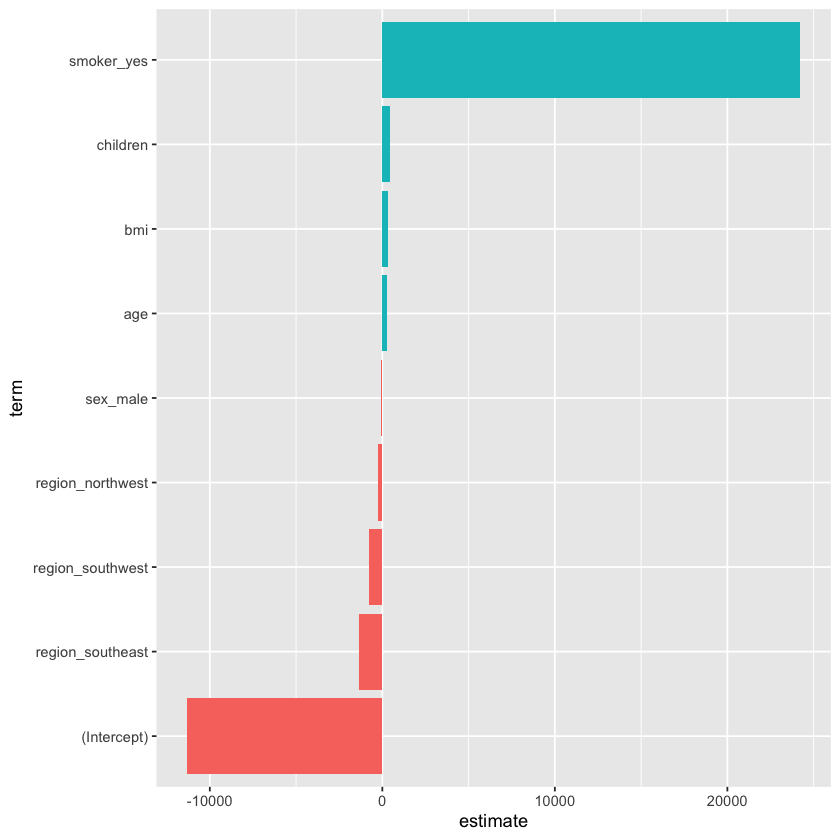

In [43]:
set.seed(1234)
lm_fit <- workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(lm_spec) %>%
    fit(data = train_tbl)
lm_fit

coeffs <- tidy(extract_fit_parsnip(lm_fit))
coeffs

lm_fit %>%
    tidy() %>%
    mutate(term = fct_reorder(term, estimate)) %>%
    ggplot(aes(estimate, term, fill = estimate > 0)) +
    geom_col() +
    theme(legend.position = "none")


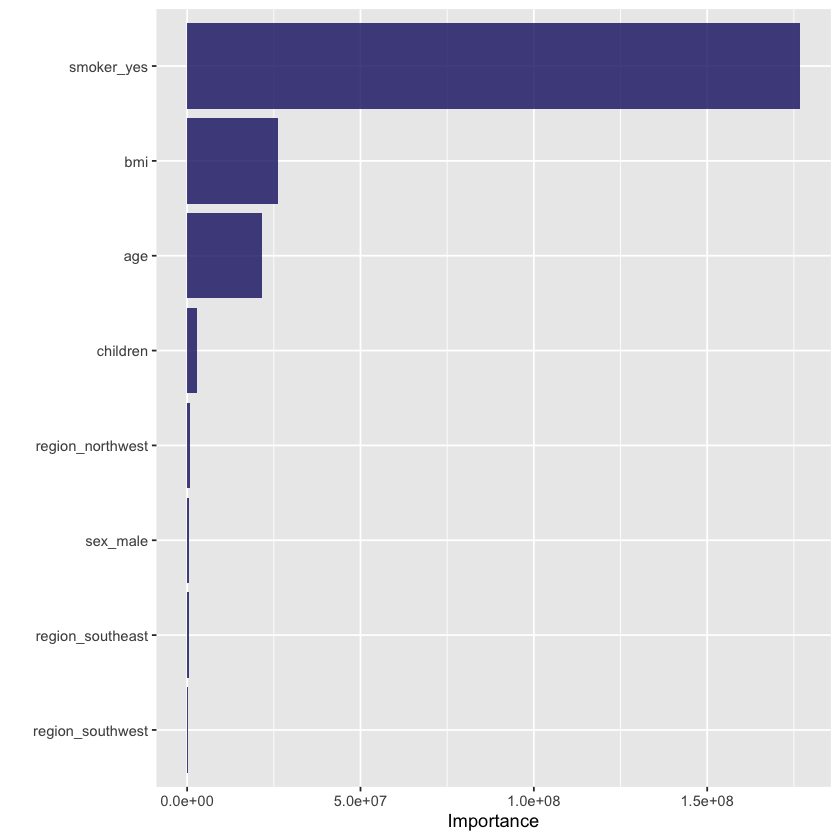

In [42]:
set.seed(1234)
rf_imp_spec <- rf_spec %>%
    set_engine("ranger", importance = "permutation")

workflow() %>%
    add_recipe(the_recipe) %>%
    add_model(rf_imp_spec) %>%
    fit(train_tbl) %>%
    extract_fit_parsnip() %>%
    vip(aesthetics = list(alpha = 0.8, fill = "midnightblue"))